In [ ]:
!pip install q kaggle

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!mkdir ~/.kaggle


In [ ]:
!cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# WHICH DATASET
!kaggle datasets download -d mehradaria/leukemia

 97% 107M/110M [00:00<00:00, 138MB/s] 
100% 110M/110M [00:00<00:00, 121MB/s]


In [ ]:
! unzip /content/leukemia.zip

Streaming output truncated to the last 5000 lines.
  inflating: Original/Pre/WBC-Malignant-Pre-024.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-025.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-026.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-027.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-028.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-029.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-030.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-031.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-032.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-033.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-034.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-035.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-036.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-037.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-038.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-039.jpg  
  inflating: Original/Pre/WBC-Malignant-Pre-040.jpg  
  inflating: Original/Pre/WBC-M

#import module

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(style="whitegrid")
import os
import glob as gb
import tensorflow as tf
import keras
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img,img_to_array
from tensorflow.keras.preprocessing import image
from tensorflow.keras.utils import to_categorical

In [ ]:
code = {"Benign":0 ,"Early":1,"Pre":2,"Pro":3}

def getcode(n) :
    for x , y in code.items() :
        if n == y :
            return x

In [ ]:
s=224

In [ ]:
import cv2
from tqdm import tqdm
import os

In [ ]:
X_train = []
y_train = []
for img in tqdm(os.listdir('/content/Original/Benign')):
    image = cv2.imread(os.path.join('/content/Original/Benign',img),1)
    image_array = cv2.resize(image , (s,s))
    X_train.append(list(image_array))
    y_train.append(code['Benign'])

100%|██████████| 504/504 [00:01<00:00, 397.26it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Early')):
    image = cv2.imread(os.path.join('/content/Original/Early',img),1)
    image_array = cv2.resize(image , (s,s))
    X_train.append(list(image_array))
    y_train.append(code['Early'])

100%|██████████| 985/985 [00:02<00:00, 478.80it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Pre')):
    image = cv2.imread(os.path.join('/content/Original/Pre',img),1)
    image_array = cv2.resize(image , (s,s))
    X_train.append(list(image_array))
    y_train.append(code['Pre'])

100%|██████████| 963/963 [00:02<00:00, 425.17it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Pro')):
    image = cv2.imread(os.path.join('/content/Original/Pro',img),1)
    image_array = cv2.resize(image , (s,s))
    X_train.append(list(image_array))
    y_train.append(code['Pro'])

100%|██████████| 804/804 [00:03<00:00, 240.90it/s]


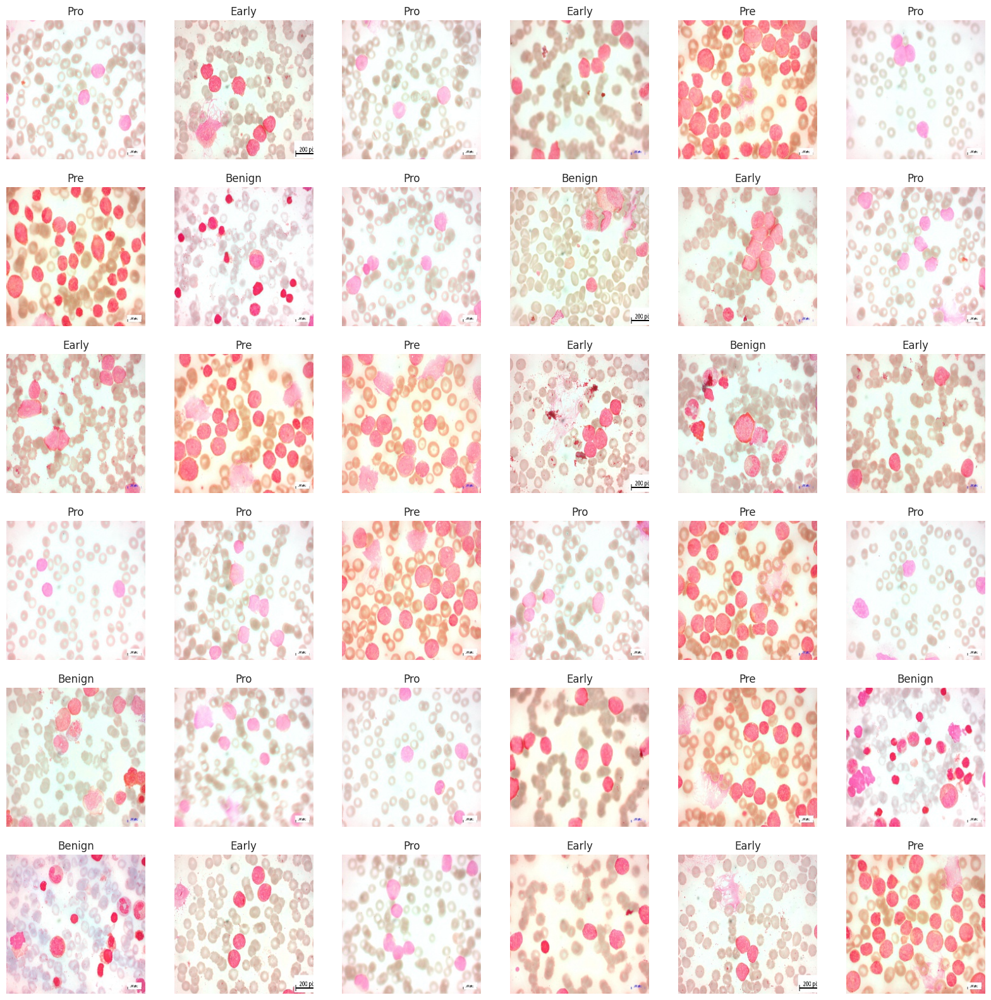

In [ ]:
plt.figure(figsize=(20,20))
for n , i in enumerate(list(np.random.randint(0,len(X_train),36))) :
    plt.subplot(6,6,n+1)
    plt.imshow(X_train[i])
    plt.axis('off')
    plt.title(getcode(y_train[i]))

In [ ]:
len(X_train)

3256

In [ ]:
X_test = []
y_test = []
for img in tqdm(os.listdir('/content/Original/Benign')):
    image = cv2.imread(os.path.join('/content/Original/Benign',img),1)
    image_array = cv2.resize(image , (s,s))
    X_test.append(list(image_array))
    y_test.append(code['Benign'])

100%|██████████| 504/504 [00:00<00:00, 589.19it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Early')):
    image = cv2.imread(os.path.join('/content/Original/Early',img),1)
    image_array = cv2.resize(image , (s,s))
    X_test.append(list(image_array))
    y_test.append(code['Early'])

100%|██████████| 985/985 [00:01<00:00, 785.26it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Pre')):
    image = cv2.imread(os.path.join('/content/Original/Pre',img),1)
    image_array = cv2.resize(image ,(s,s))
    X_test.append(list(image_array))
    y_test.append(code['Pre'])

100%|██████████| 963/963 [00:00<00:00, 1024.07it/s]


In [ ]:
for img in tqdm(os.listdir('/content/Original/Pro')):
    image = cv2.imread(os.path.join('/content/Original/Pro',img),1)
    image_array = cv2.resize(image ,(s,s))
    X_test.append(list(image_array))
    y_test.append(code['Pro'])

100%|██████████| 804/804 [00:00<00:00, 1091.68it/s]


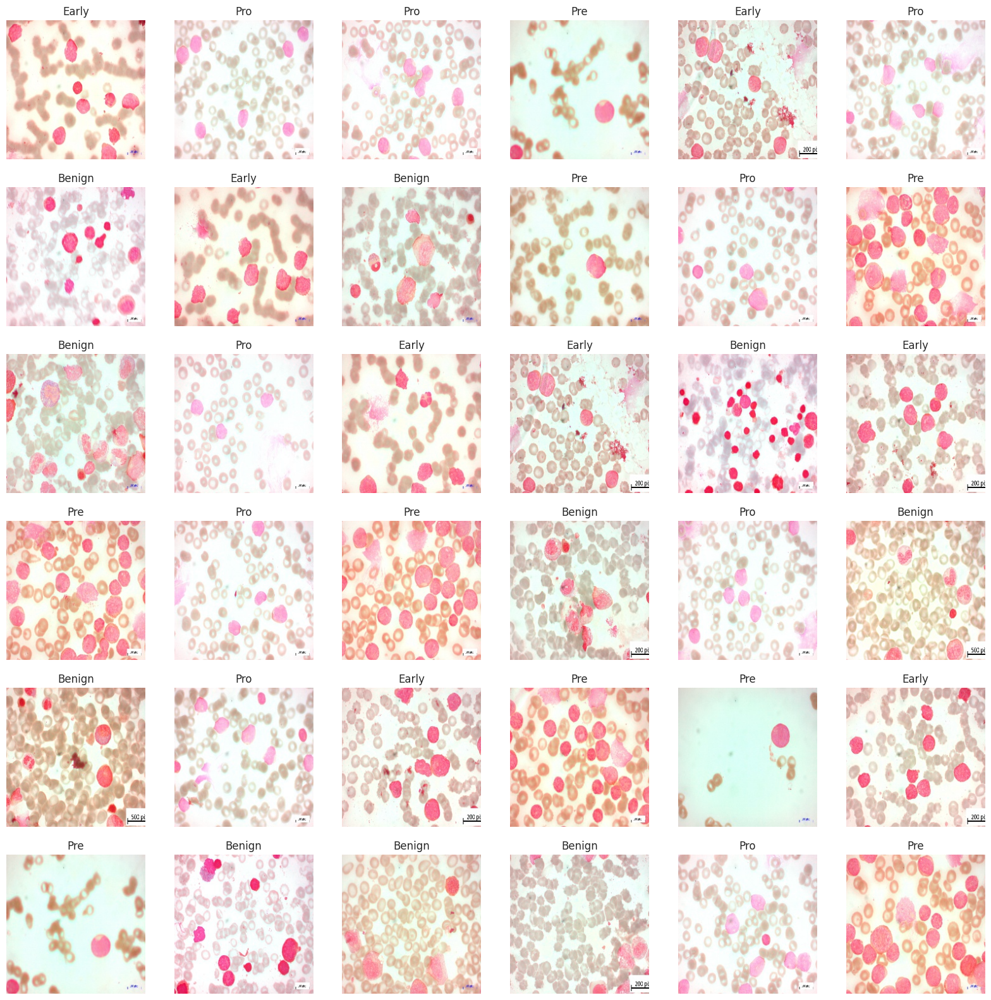

In [ ]:
plt.figure(figsize=(20,20))
for n , i in enumerate(list(np.random.randint(0,len(X_test),36))) :
    plt.subplot(6,6,n+1)
    plt.imshow(X_test[i])
    plt.axis('off')
    plt.title(getcode(y_test[i]))

In [ ]:
da=[]
for i,j in zip(X_train,y_train):
    da.append([i,j])

In [ ]:
import random
random.shuffle(da)

In [ ]:
len(da)

3256

In [ ]:
X=[]
y=[]
for img,label in da:
    X.append(img)
    y.append(label)

In [ ]:
X=np.array(X)
y=np.array(y)

In [ ]:
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest = train_test_split(X,y,train_size=0.8,shuffle=True)
print(xtest.shape)
print(xtrain.shape)

(652, 224, 224, 3)
(2604, 224, 224, 3)


#**customized** **CNN**

## 4 convolutional layers, 2 max pooling layers,and 5 fully connected layers

In [ ]:
KerasModel = keras.models.Sequential([
        keras.layers.Conv2D(200,kernel_size=(3,3),activation='relu',input_shape=(100,100,3)),
        keras.layers.Conv2D(150,kernel_size=(3,3),activation='relu'),
        keras.layers.MaxPool2D(4,4),
        keras.layers.Dropout(rate=0.8) ,
        keras.layers.Conv2D(120,kernel_size=(3,3),activation='relu'),
        keras.layers.Dropout(rate=0.8) ,
        keras.layers.Conv2D(50,kernel_size=(3,3),activation='relu'),
        keras.layers.MaxPool2D(4,4),
        keras.layers.Flatten() ,
        keras.layers.Dense(256,activation='relu') ,
        keras.layers.BatchNormalization(),
        keras.layers.Dropout(rate=0.8) ,
        keras.layers.Dense(128,activation='relu') ,
        keras.layers.BatchNormalization(),
        keras.layers.Dense(100,activation='relu') ,
        keras.layers.BatchNormalization(),
        keras.layers.Dense(50,activation='relu') ,
        keras.layers.BatchNormalization(),
        keras.layers.Dropout(rate=0.8) ,
        keras.layers.Dense(4,activation='softmax') ,
        ])

In [ ]:
m_model=tf.keras.applications.vgg19.VGG19()
model1=tf.keras.models.Sequential()
for layer in m_model.layers[:-1]:
    model1.add(layer)
for layer in model1.layers:
    layer.trainable=False
model1.add(tf.keras.layers.Dense(4,activation=tf.nn.softmax))

574710816/574710816 [==============================] - 5s 0us/step


In [ ]:
model1.compile(optimizer ='adam',loss='sparse_categorical_crossentropy',metrics=['accuracy'])

In [ ]:
print('Model Details are : ')
print(model1.summary())

Model Details are : 
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0         
                                                                 
 block3_conv1 (Conv2D)       (Non

In [ ]:
history=model1.fit(xtrain,ytrain,batch_size=128,
                  verbose=1,
                  validation_data=(xtest,ytest),epochs=20)

Epoch 1/20
21/21 [==============================] - 45s 1s/step - loss: 0.7638 - accuracy: 0.7008 - val_loss: 0.3735 - val_accuracy: 0.8512
Epoch 2/20
21/21 [==============================] - 17s 804ms/step - loss: 0.2585 - accuracy: 0.9121 - val_loss: 0.2365 - val_accuracy: 0.9202
Epoch 3/20
21/21 [==============================] - 17s 810ms/step - loss: 0.1691 - accuracy: 0.9508 - val_loss: 0.1979 - val_accuracy: 0.9310
Epoch 4/20
21/21 [==============================] - 17s 819ms/step - loss: 0.1392 - accuracy: 0.9604 - val_loss: 0.1778 - val_accuracy: 0.9356
Epoch 5/20
21/21 [==============================] - 15s 718ms/step - loss: 0.1152 - accuracy: 0.9677 - val_loss: 0.1515 - val_accuracy: 0.9509
Epoch 6/20
21/21 [==============================] - 17s 841ms/step - loss: 0.0989 - accuracy: 0.9720 - val_loss: 0.1515 - val_accuracy: 0.9540
Epoch 7/20
21/21 [==============================] - 18s 845ms/step - loss: 0.0883 - accuracy: 0.9750 - val_loss: 0.1351 - val_accuracy: 0.9571
Ep

In [ ]:
y_pred = model1.predict(xtest)

print('Prediction Shape is {}'.format(y_pred.shape))

21/21 [==============================] - 10s 150ms/step
Prediction Shape is (652, 4)


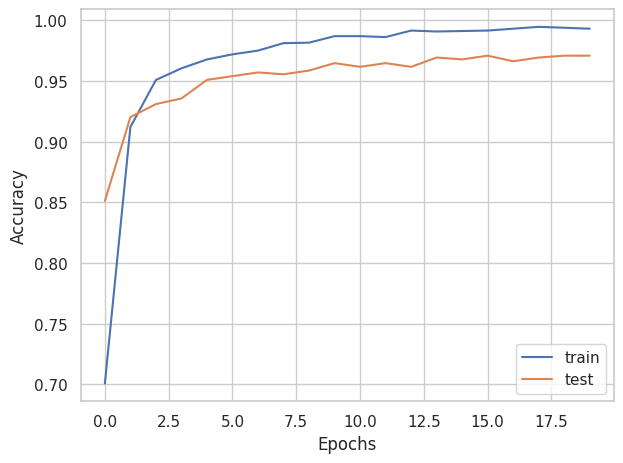

In [ ]:
import matplotlib.pyplot as plt
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend(['train','test'],loc='lower right')
plt.tight_layout()

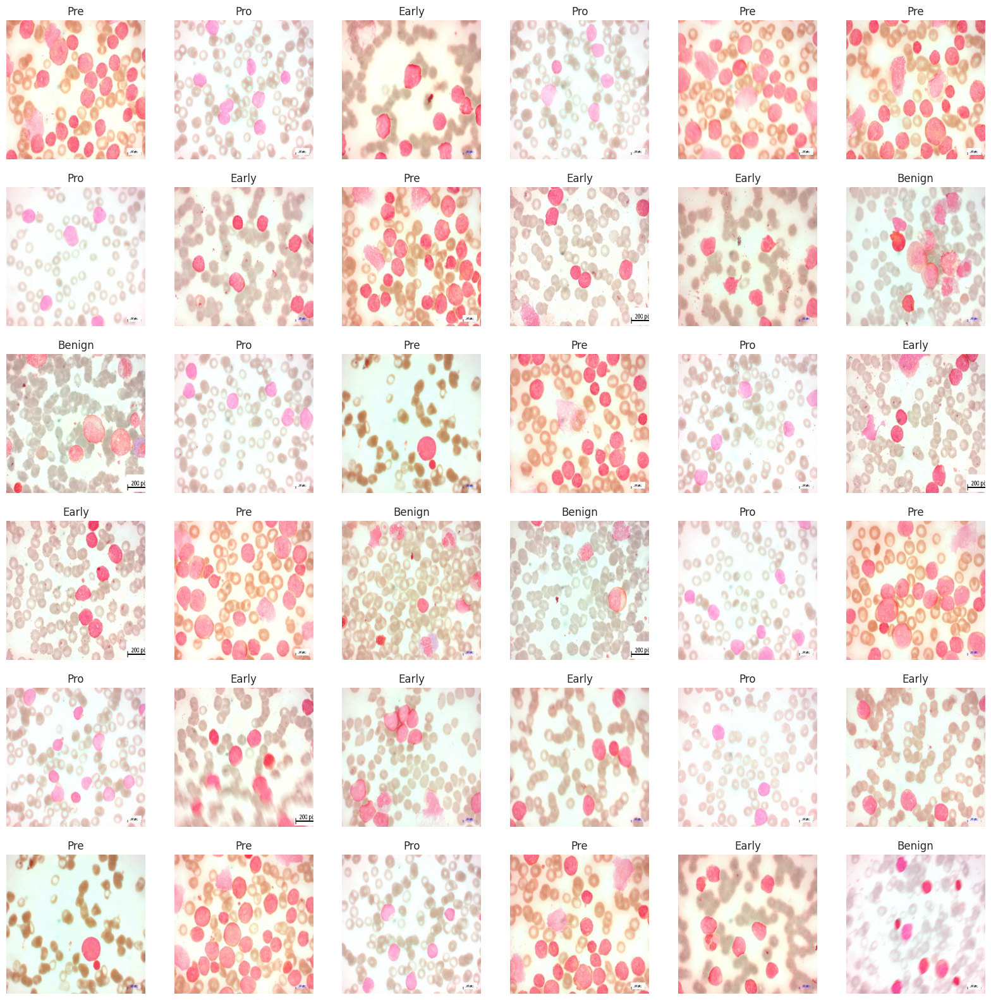

In [ ]:
plt.figure(figsize=(20,20))
for n , i in enumerate(list(np.random.randint(0,len(xtest),36))) :
    plt.subplot(6,6,n+1)
    plt.imshow(xtest[i])
    plt.axis('off')
    plt.title(getcode(np.argmax(y_pred[i])))

#Segmentation Unet

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf

import keras.backend as K
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import os

In [ ]:
files=[]
paths = []
for dirname, _, filenames in os.walk('/content/Original/Pro'):
    for filename in filenames:
        path = os.path.join(dirname, filename)
        paths.append(path)
        files.append(filename)

In [ ]:
mpaths = []
for dirname, _, filenames in os.walk('/content/Segmented/Pro'):
    for filename in filenames:
        path = os.path.join(dirname, filename)
        mpaths.append(path)

In [ ]:
df0=pd.DataFrame(columns=['file','path','mpath'])
df0['file']=sorted(files)
df0['path']=sorted(paths)
df0['mpath']=sorted(mpaths)
display(df0)
df=df0.iloc[0:len(df0)//2]
test_df=df0.iloc[len(df0)//2:]

,file,path,mpath
0,WBC-Malignant-Pro-001.jpg,/content/Original/Pro/WBC-Malignant-Pro-001.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-001.jpg
1,WBC-Malignant-Pro-002.jpg,/content/Original/Pro/WBC-Malignant-Pro-002.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-002.jpg
2,WBC-Malignant-Pro-003.jpg,/content/Original/Pro/WBC-Malignant-Pro-003.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-003.jpg
3,WBC-Malignant-Pro-004.jpg,/content/Original/Pro/WBC-Malignant-Pro-004.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-004.jpg
4,WBC-Malignant-Pro-005.jpg,/content/Original/Pro/WBC-Malignant-Pro-005.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-005.jpg
...,...,...,...
799,WBC-Malignant-Pro-800.jpg,/content/Original/Pro/WBC-Malignant-Pro-800.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-800.jpg
800,WBC-Malignant-Pro-801.jpg,/content/Original/Pro/WBC-Malignant-Pro-801.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-801.jpg
801,WBC-Malignant-Pro-802.jpg,/content/Original/Pro/WBC-Malignant-Pro-802.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-802.jpg
802,WBC-Malignant-Pro-803.jpg,/content/Original/Pro/WBC-Malignant-Pro-803.jpg,/content/Segmented/Pro/WBC-Malignant-Pro-803.jpg


In [ ]:
img_size = [256,256]

def data_augmentation(car_img, mask_img):
    if tf.random.uniform(()) > 0.5:
        car_img = tf.image.flip_left_right(car_img)
        mask_img = tf.image.flip_left_right(mask_img)

    return car_img, mask_img

def preprocessing(car_path, mask_path):
    car_img = tf.io.read_file(car_path)
    car_img = tf.image.decode_jpeg(car_img, channels=3)
    car_img = tf.image.resize(car_img, img_size)
    car_img = tf.cast(car_img, tf.float32) / 255.0

    mask_img = tf.io.read_file(mask_path)
    mask_img = tf.image.decode_jpeg(mask_img, channels=3)
    mask_img = tf.image.resize(mask_img, img_size)
    mask_img = mask_img[:,:,:1]
    mask_img = tf.math.sign(mask_img)

    return car_img, mask_img

def create_dataset(df, train = False):
    if not train:
        ds = tf.data.Dataset.from_tensor_slices((df["path"].values, df["mpath"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
    else:
        ds = tf.data.Dataset.from_tensor_slices((df["path"].values, df["mpath"].values))
        ds = ds.map(preprocessing, tf.data.AUTOTUNE)
        ds = ds.map(data_augmentation, tf.data.AUTOTUNE)

    return ds

In [ ]:
train_df, valid_df = train_test_split(df, random_state=42, test_size=.25)
train = create_dataset(train_df, train = True)
valid = create_dataset(valid_df)
test = create_dataset(test_df)

In [ ]:
TRAIN_LENGTH = len(train_df)
BATCH_SIZE = 16
BUFFER_SIZE = 1000

In [ ]:
train_dataset = train.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_dataset = train_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
valid_dataset = valid.batch(BATCH_SIZE)
test_dataset = test.batch(BATCH_SIZE)

In [ ]:
def display(display_list):
    plt.figure(figsize=(12,12))

    title = ['Input Image', 'True Mask', 'Predicted Mask']

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

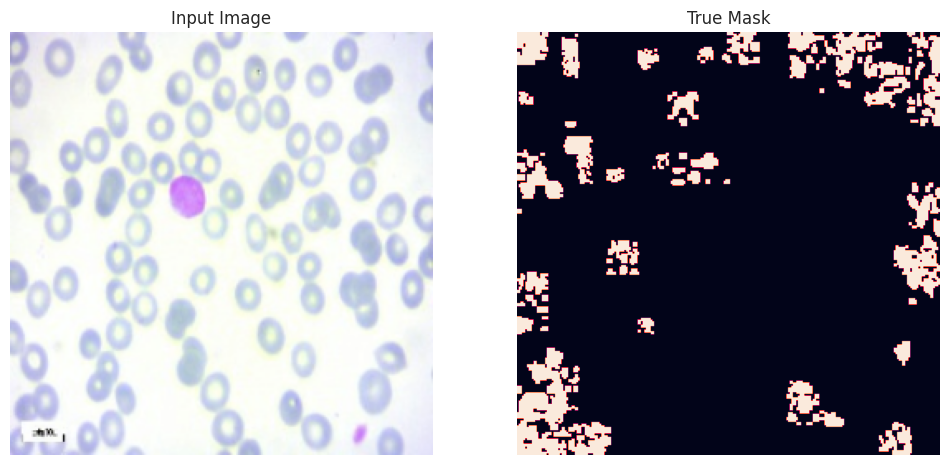

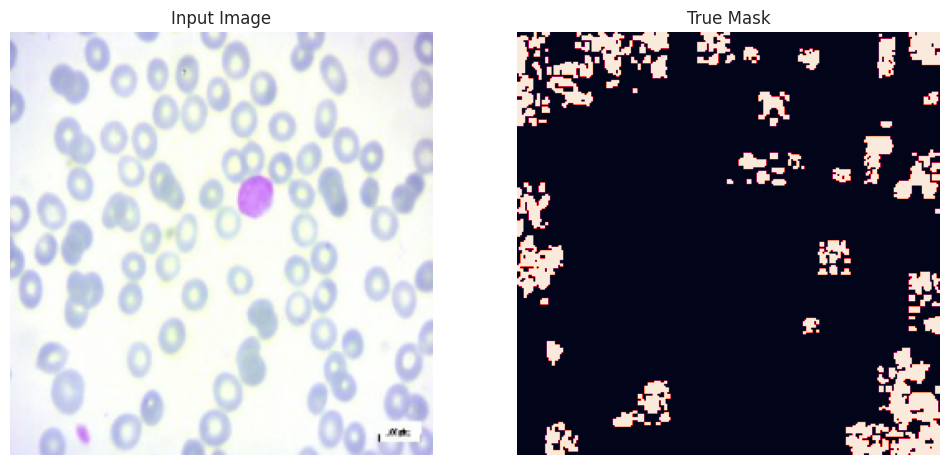

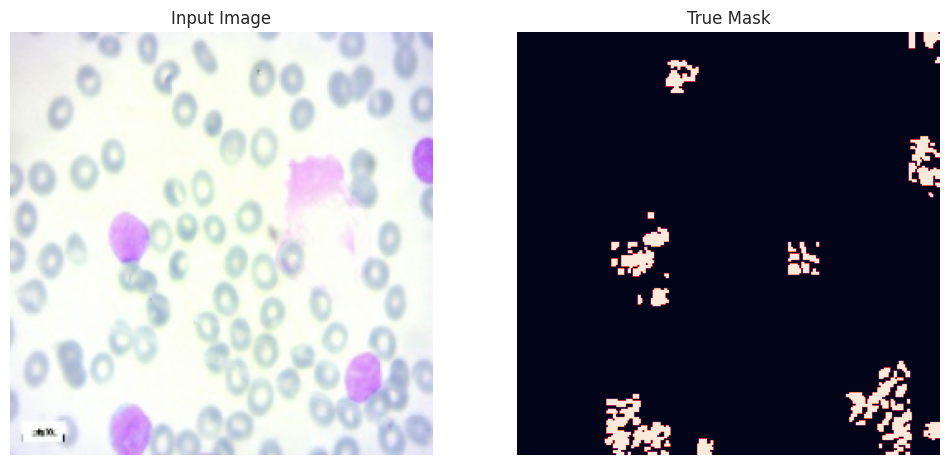

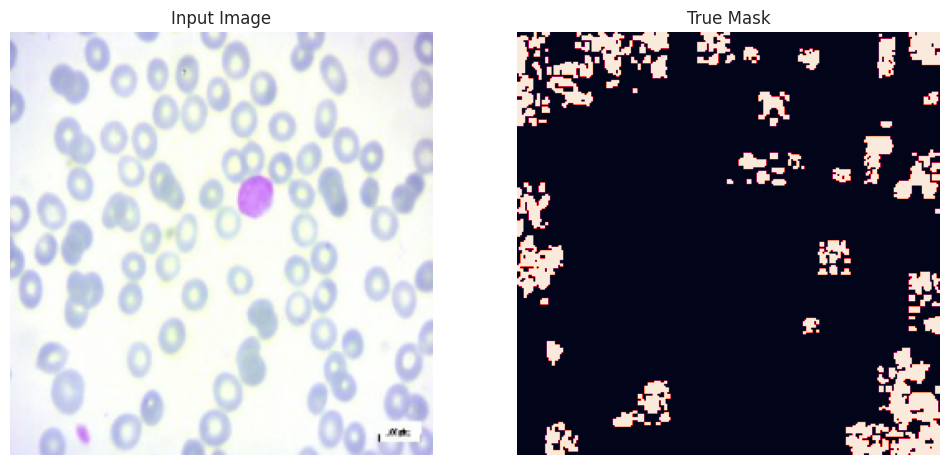

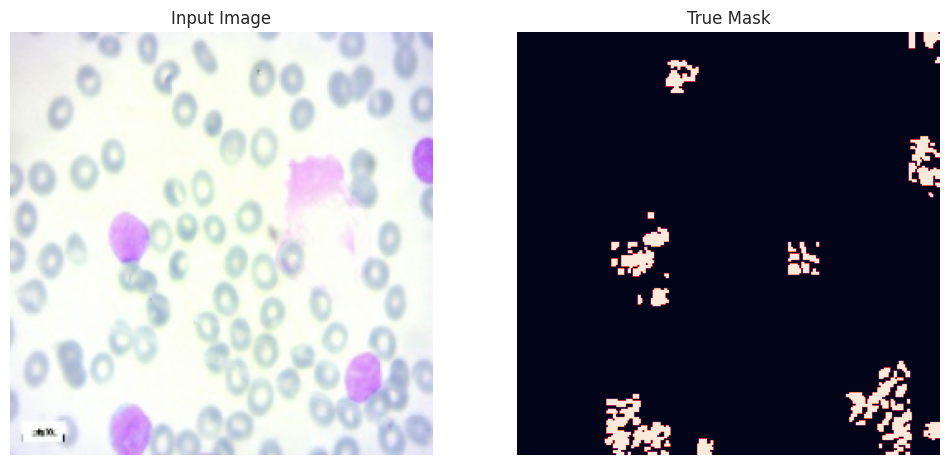

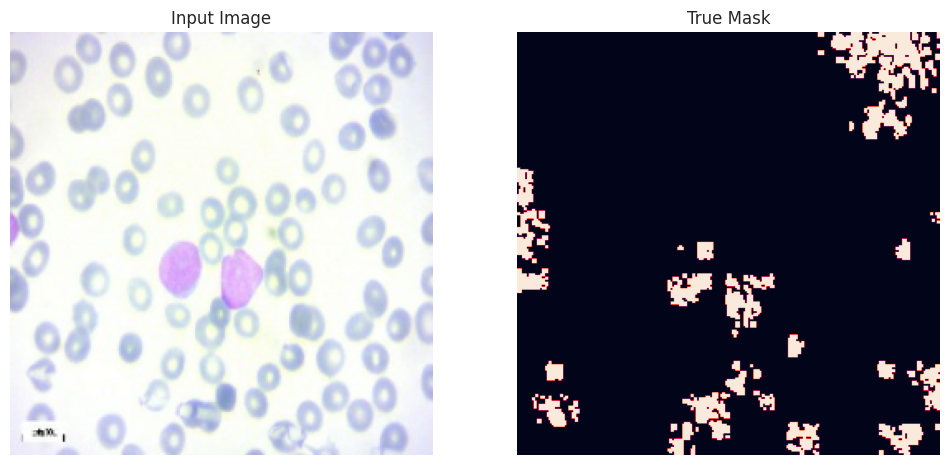

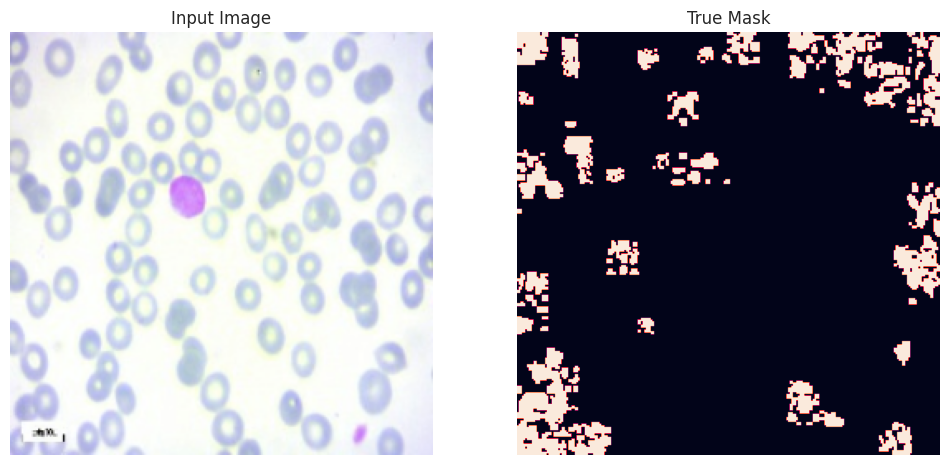

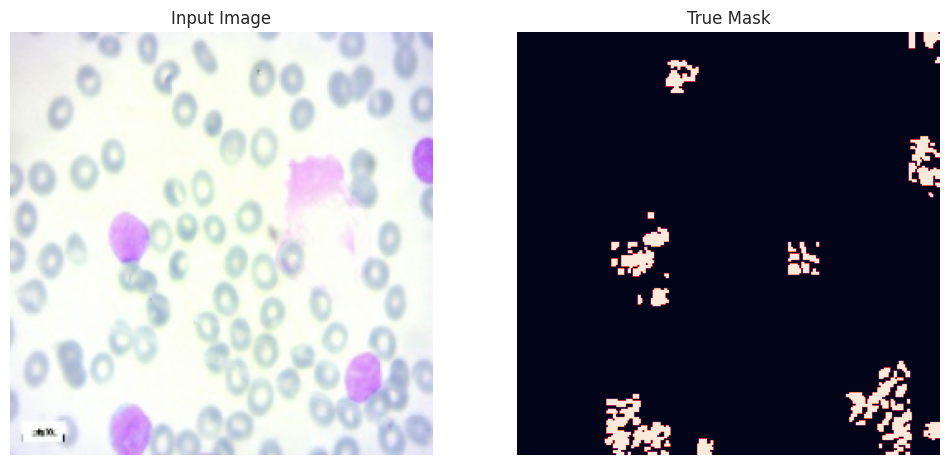

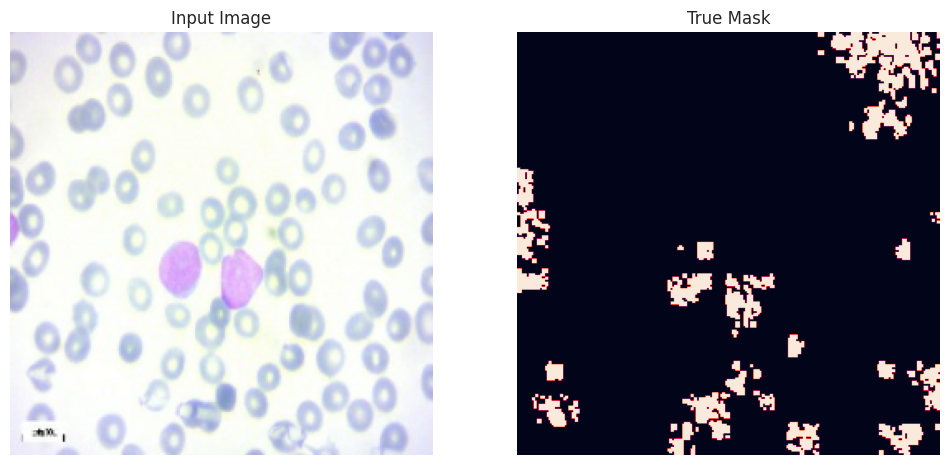

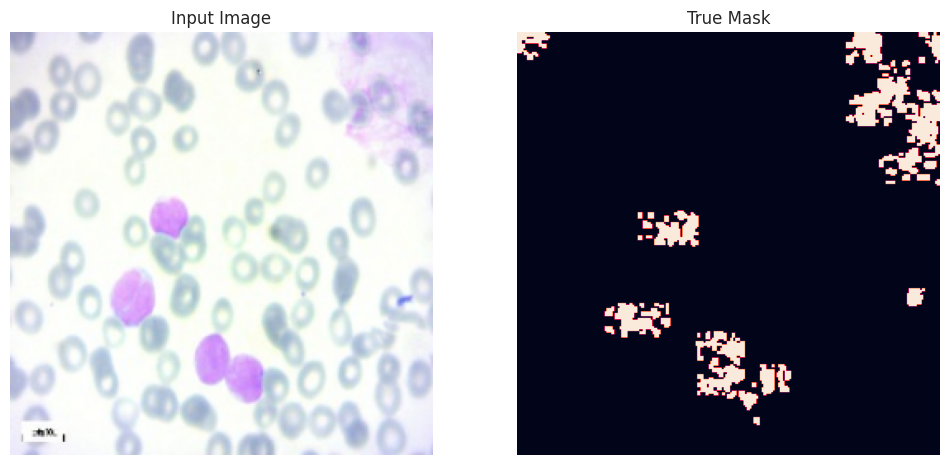

In [ ]:
for i in range(5):
    for image, mask in train.take(i):
        sample_image, sample_mask = image, mask
        display([sample_image, sample_mask])

#MobileNetV2 Model

In [ ]:
base_model = tf.keras.applications.MobileNetV2(input_shape=[256, 256, 3], include_top=False)

# Use the activations of these layers
layer_names = [
    'block_1_expand_relu',   # 64x64
    'block_3_expand_relu',   # 32x32
    'block_6_expand_relu',   # 16x16
    'block_13_expand_relu',  # 8x8
    'block_16_project',      # 4x4
]
base_model_outputs = [base_model.get_layer(name).output for name in layer_names]

# Create the feature extraction model
down_stack = tf.keras.Model(inputs=base_model.input, outputs=base_model_outputs)
down_stack.trainable = False

9406464/9406464 [==============================] - 0s 0us/step


In [ ]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    if norm_type.lower() == 'batchnorm':
        result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
        result.add(InstanceNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

        result.add(tf.keras.layers.ReLU())

    return result

up_stack = [
    upsample(512, 3),  # 4x4 -> 8x8
    upsample(256, 3),  # 8x8 -> 16x16
    upsample(128, 3),  # 16x16 -> 32x32
    upsample(64, 3),   # 32x32 -> 64x64
]

In [ ]:
def unet_model(output_channels):
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    # Downsampling through the model
    skips = down_stack(inputs)
    x = skips[-1]
    skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        concat = tf.keras.layers.Concatenate()
        x = concat([x, skip])

  # This is the last layer of the model
    last = tf.keras.layers.Conv2DTranspose(
      output_channels, 3, strides=2, activation='sigmoid',
      padding='same')  #64x64 -> 128x128

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

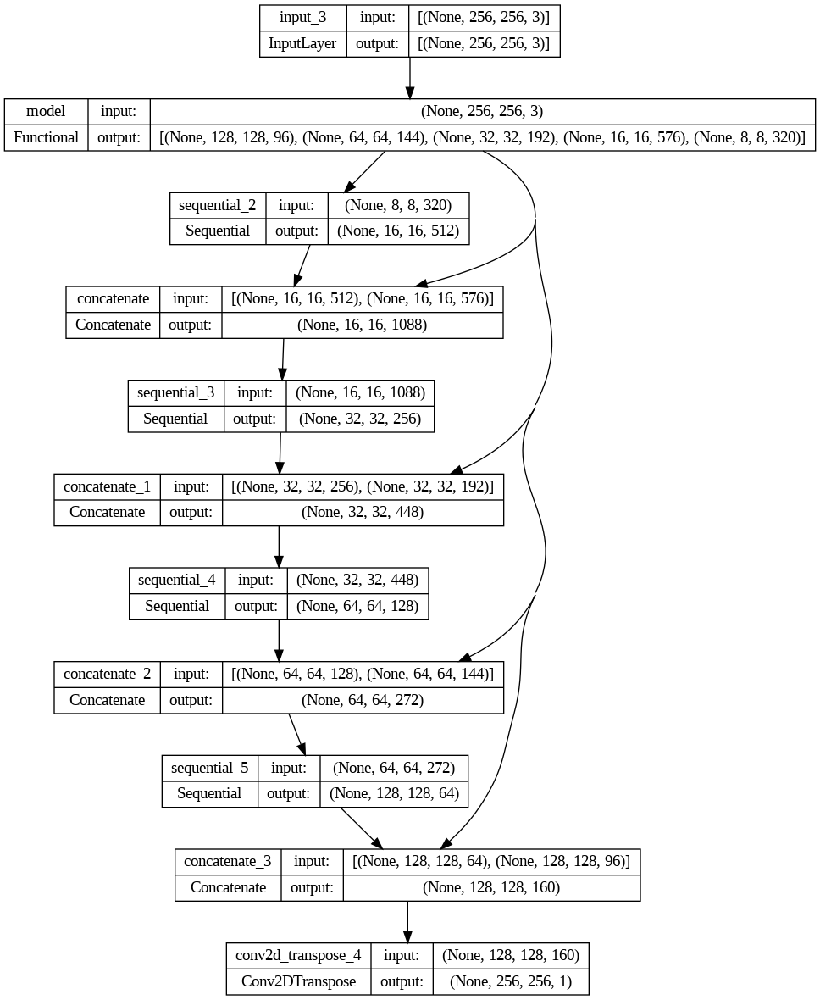

In [ ]:
def dice_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(y_true * y_pred, axis=[1,2,3])
    union = K.sum(y_true, axis=[1,2,3]) + K.sum(y_pred, axis=[1,2,3])
    return K.mean( (2. * intersection + smooth) / (union + smooth), axis=0)

def dice_loss(in_gt, in_pred):
    return 1-dice_coef(in_gt, in_pred)

model = unet_model(1)

model.compile(optimizer='adam',
              loss = dice_loss,
              run_eagerly=True,
              metrics=[dice_coef,'binary_accuracy'])

tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
def visualize(display_list):
    plt.figure(figsize=(12,12))
    title = ['Input Image', 'True Mask', 'Predicted Mask']
    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i+1)
        plt.title(title[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

def show_predictions(sample_image, sample_mask):
    pred_mask = model.predict(sample_image[tf.newaxis, ...])
    pred_mask = pred_mask.reshape(img_size[0],img_size[1],1)
    visualize([sample_image, sample_mask, pred_mask])

1/1 [==============================] - 2s 2s/step


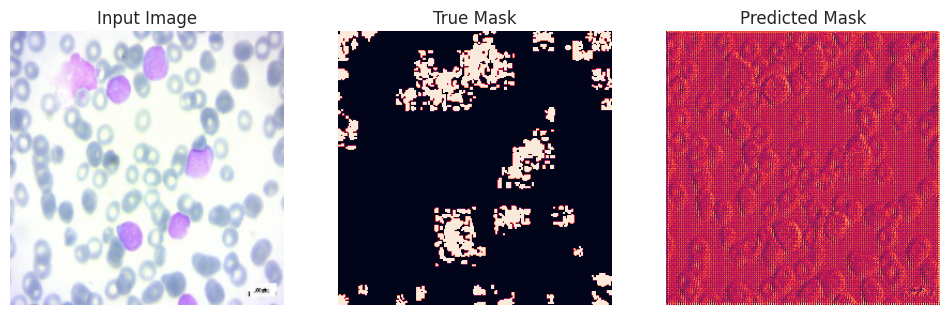

1/1 [==============================] - 0s 103ms/step


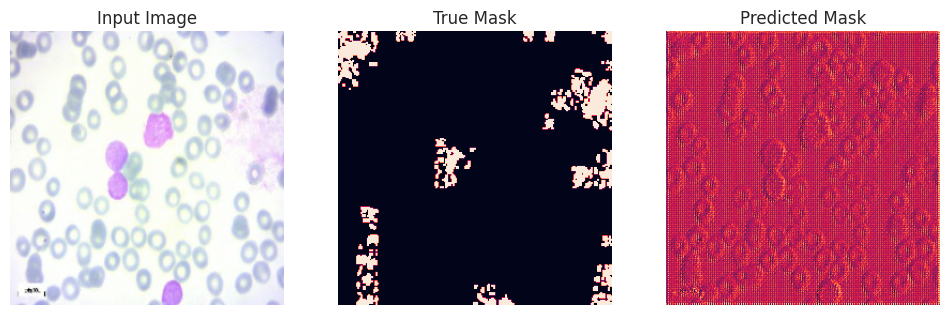

1/1 [==============================] - 0s 110ms/step


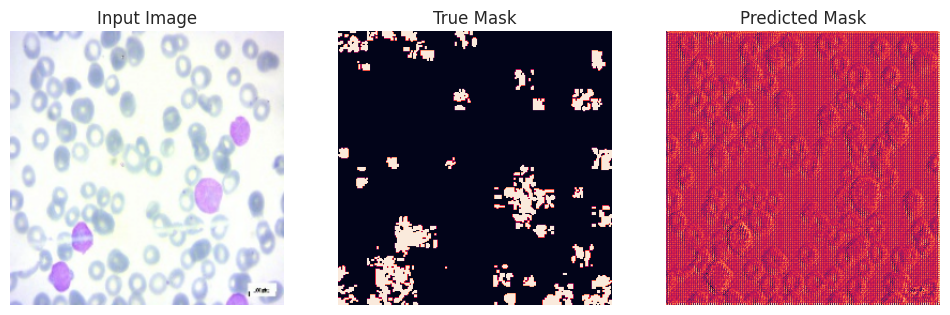

1/1 [==============================] - 0s 110ms/step


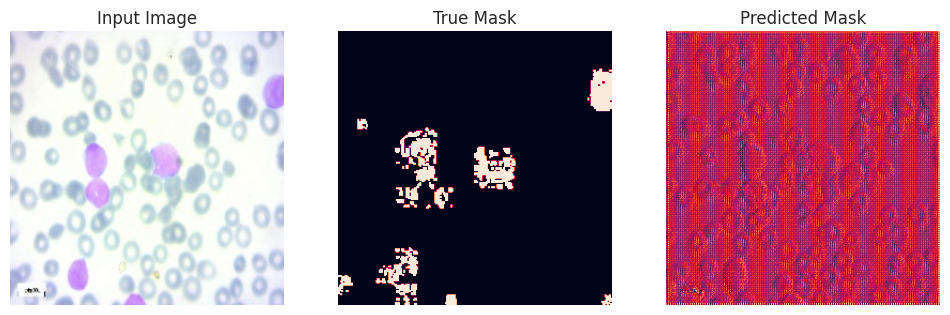

1/1 [==============================] - 0s 117ms/step


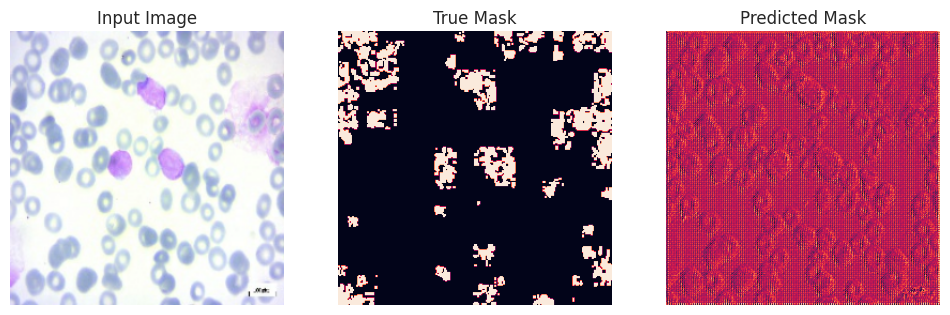

1/1 [==============================] - 0s 112ms/step


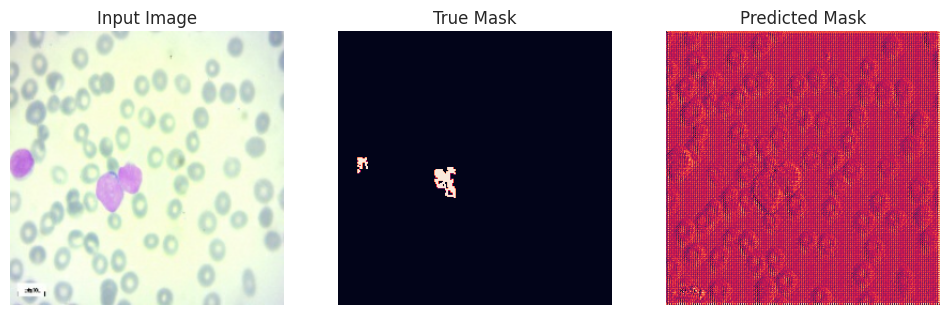

1/1 [==============================] - 0s 101ms/step


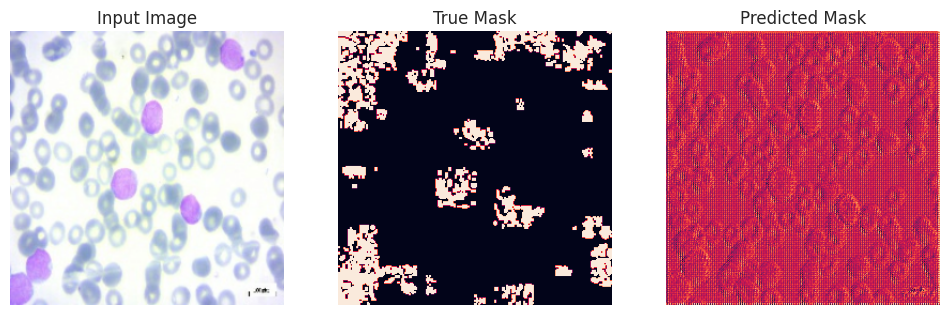

1/1 [==============================] - 0s 132ms/step


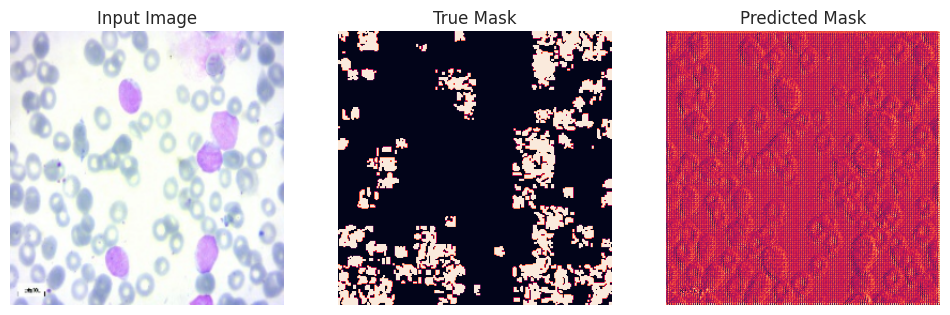

1/1 [==============================] - 0s 120ms/step


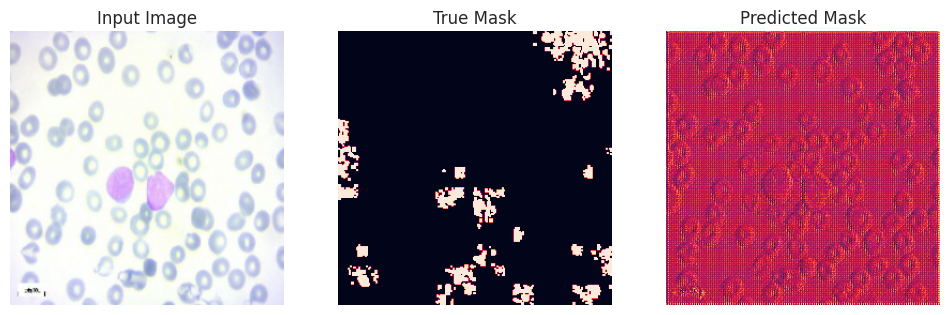

1/1 [==============================] - 0s 186ms/step


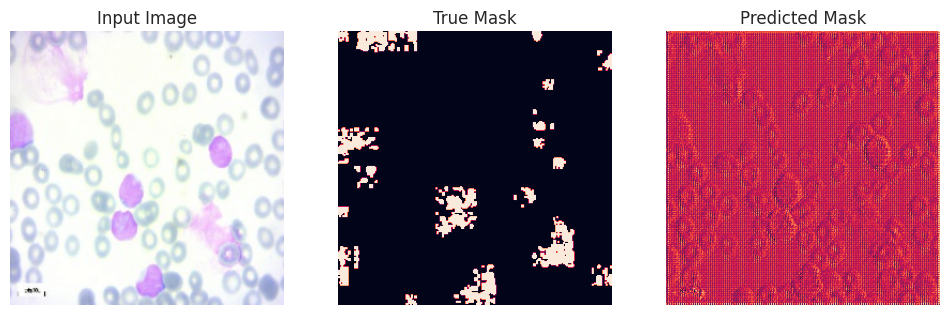

In [ ]:
for i in range(5):
    for images, masks in train_dataset.take(i):
        for img, mask in zip(images, masks):
            sample_image = img
            sample_mask = mask
            show_predictions(sample_image, sample_mask)
            break

Epoch 1/30


18/18 [==============================] - 13s 423ms/step - loss: 0.7000 - dice_coef: 0.3000 - binary_accuracy: 0.6001 - val_loss: 0.6698 - val_dice_coef: 0.3350 - val_binary_accuracy: 0.5914
Epoch 2/30
1/1 [==============================] - 0s 107ms/step


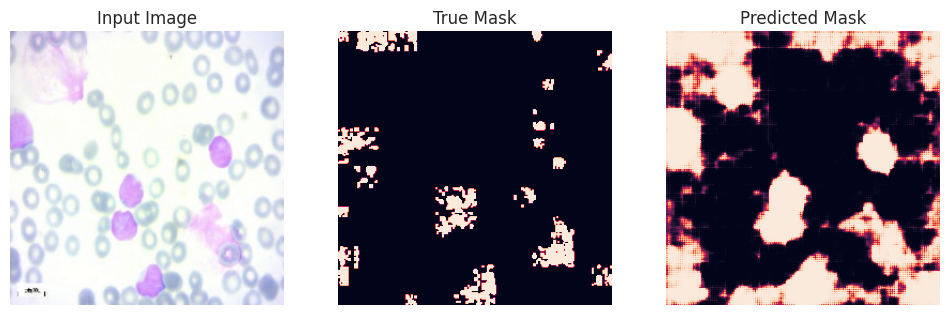

Epoch 3/30
18/18 [==============================] - 6s 326ms/step - loss: 0.5270 - dice_coef: 0.4730 - binary_accuracy: 0.8646 - val_loss: 0.5409 - val_dice_coef: 0.4651 - val_binary_accuracy: 0.8251
Epoch 4/30
18/18 [==============================] - 6s 333ms/step - loss: 0.5117 - dice_coef: 0.4880 - binary_accuracy: 0.8681 - val_loss: 0.5209 - val_dice_coef: 0.4845 - val_binary_accuracy: 0.8469
Epoch 5/30
1/1 [==============================] - 0s 102ms/step


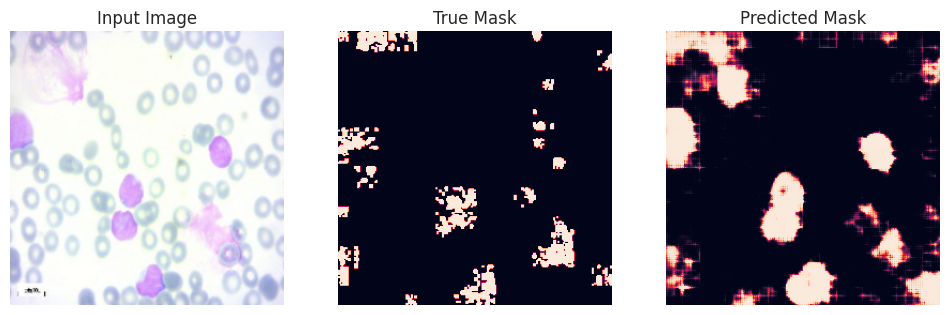

Epoch 6/30
18/18 [==============================] - 5s 305ms/step - loss: 0.4929 - dice_coef: 0.5068 - binary_accuracy: 0.8722 - val_loss: 0.5179 - val_dice_coef: 0.4877 - val_binary_accuracy: 0.8544
Epoch 7/30
18/18 [==============================] - 6s 328ms/step - loss: 0.4936 - dice_coef: 0.5062 - binary_accuracy: 0.8744 - val_loss: 0.5315 - val_dice_coef: 0.4738 - val_binary_accuracy: 0.8866
Epoch 8/30
1/1 [==============================] - 0s 101ms/step


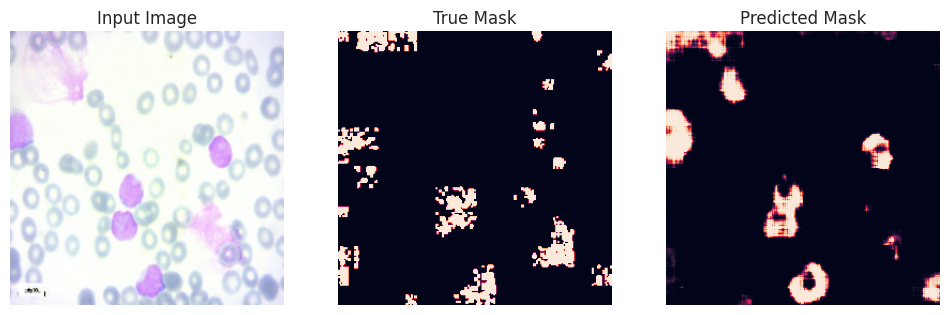

Epoch 9/30
18/18 [==============================] - 6s 358ms/step - loss: 0.4839 - dice_coef: 0.5161 - binary_accuracy: 0.8797 - val_loss: 0.5527 - val_dice_coef: 0.4527 - val_binary_accuracy: 0.8890


In [ ]:
early_stop = tf.keras.callbacks.EarlyStopping(patience=4,restore_best_weights=True)

class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_begin(self, epoch, logs=None):
        if (epoch + 1) % 3 == 0:
            show_predictions(sample_image, sample_mask)
EPOCHS = 30
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

model_history = model.fit(train_dataset, epochs=EPOCHS,
                          steps_per_epoch=STEPS_PER_EPOCH,
                          validation_data=valid_dataset,
                          callbacks=[DisplayCallback(), early_stop])

##RESNET50**

In [ ]:
import tensorflow as tf

resnet_model = tf.keras.applications.ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))


for layer in resnet_model.layers:
    layer.trainable = False


model_resnet = tf.keras.models.Sequential()
model_resnet.add(resnet_model)


model_resnet.add(tf.keras.layers.GlobalAveragePooling2D())
model.add(Dropout(0.8))

model_resnet.add(tf.keras.layers.Dense(4, activation='softmax'))


model_resnet.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [ ]:
model_resnet.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d_2  (None, 2048)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_33 (Dense)            (None, 4)                 8196      
                                                                 
Total params: 23595908 (90.01 MB)
Trainable params: 8196 (32.02 KB)
Non-trainable params: 23587712 (89.98 MB)
_________________________________________________________________


In [ ]:

history_resnet = model_resnet.fit(xtrain, ytrain, batch_size=128, verbose=1, validation_data=(xtest, ytest), epochs=15)


accuracy = history_resnet.history['accuracy']
val_accuracy = history_resnet.history['val_accuracy']


for epoch, acc, val_acc in zip(range(1, 21), accuracy, val_accuracy):
    print(f'Epoch {epoch}: Accuracy - {acc:.4f}, Validation Accuracy - {val_acc:.4f}')


Epoch 1/15
21/21 [==============================] - 13s 465ms/step - loss: 1.8092 - accuracy: 0.3848 - val_loss: 1.0492 - val_accuracy: 0.5230
Epoch 2/15
21/21 [==============================] - 9s 455ms/step - loss: 0.8326 - accuracy: 0.6989 - val_loss: 0.6230 - val_accuracy: 0.8067
Epoch 3/15
21/21 [==============================] - 9s 457ms/step - loss: 0.5364 - accuracy: 0.8376 - val_loss: 0.4453 - val_accuracy: 0.8880
Epoch 4/15
21/21 [==============================] - 9s 455ms/step - loss: 0.3948 - accuracy: 0.8940 - val_loss: 0.3467 - val_accuracy: 0.9279
Epoch 5/15
21/21 [==============================] - 9s 419ms/step - loss: 0.3109 - accuracy: 0.9293 - val_loss: 0.2817 - val_accuracy: 0.9402
Epoch 6/15
21/21 [==============================] - 9s 427ms/step - loss: 0.2562 - accuracy: 0.9505 - val_loss: 0.2407 - val_accuracy: 0.9479
Epoch 7/15
21/21 [==============================] - 10s 478ms/step - loss: 0.2211 - accuracy: 0.9585 - val_loss: 0.2119 - val_accuracy: 0.9617
Epoc

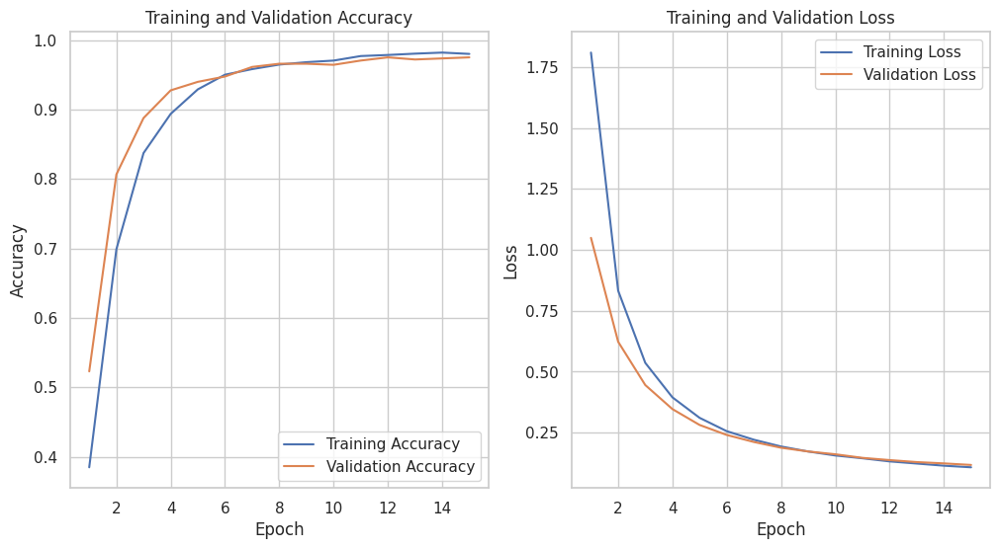

In [ ]:
import matplotlib.pyplot as plt

# Train the model and store the history
#history_resnet = model_resnet.fit(xtrain, ytrain, batch_size=128, verbose=1, validation_data=(xtest, ytest), epochs=20)

# Access accuracy, validation accuracy, loss, and validation loss from history
accuracy = history_resnet.history['accuracy']
val_accuracy = history_resnet.history['val_accuracy']
loss = history_resnet.history['loss']
val_loss = history_resnet.history['val_loss']

# Plot Training and Validation Accuracy
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(range(1, 16), accuracy, label='Training Accuracy')
plt.plot(range(1, 16), val_accuracy, label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(range(1, 16), loss, label='Training Loss')
plt.plot(range(1, 16), val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()


##Inception v3

In [ ]:
import tensorflow as tf


inception_model = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))


for layer in inception_model.layers:
    layer.trainable = False


model_inception = tf.keras.models.Sequential()
model_inception.add(inception_model)


model_inception.add(tf.keras.layers.GlobalAveragePooling2D())


model_inception.add(tf.keras.layers.Dense(4, activation='softmax'))


model_inception.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [ ]:
model_inception.summary()

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 inception_v3 (Functional)   (None, 5, 5, 2048)        21802784  
                                                                 
 global_average_pooling2d_4  (None, 2048)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_35 (Dense)            (None, 4)                 8196      
                                                                 
Total params: 21810980 (83.20 MB)
Trainable params: 8196 (32.02 KB)
Non-trainable params: 21802784 (83.17 MB)
_________________________________________________________________


In [ ]:
import matplotlib.pyplot as plt


history_inception = model_inception.fit(xtrain, ytrain, batch_size=128, verbose=1, validation_data=(xtest, ytest), epochs=20)




Epoch 1/20
21/21 [==============================] - 27s 766ms/step - loss: 10.6183 - accuracy: 0.3817 - val_loss: 4.8523 - val_accuracy: 0.4540
Epoch 2/20
21/21 [==============================] - 6s 274ms/step - loss: 4.1273 - accuracy: 0.5307 - val_loss: 3.7060 - val_accuracy: 0.5215
Epoch 3/20
21/21 [==============================] - 6s 278ms/step - loss: 2.8624 - accuracy: 0.5618 - val_loss: 1.9447 - val_accuracy: 0.6580
Epoch 4/20
21/21 [==============================] - 6s 283ms/step - loss: 1.8399 - accuracy: 0.6010 - val_loss: 1.6519 - val_accuracy: 0.6672
Epoch 5/20
21/21 [==============================] - 6s 274ms/step - loss: 1.5587 - accuracy: 0.6336 - val_loss: 1.7231 - val_accuracy: 0.6089
Epoch 6/20
21/21 [==============================] - 6s 281ms/step - loss: 1.2772 - accuracy: 0.6617 - val_loss: 1.0700 - val_accuracy: 0.7117
Epoch 7/20
21/21 [==============================] - 6s 273ms/step - loss: 1.1016 - accuracy: 0.6763 - val_loss: 1.0320 - val_accuracy: 0.6902
Epoc

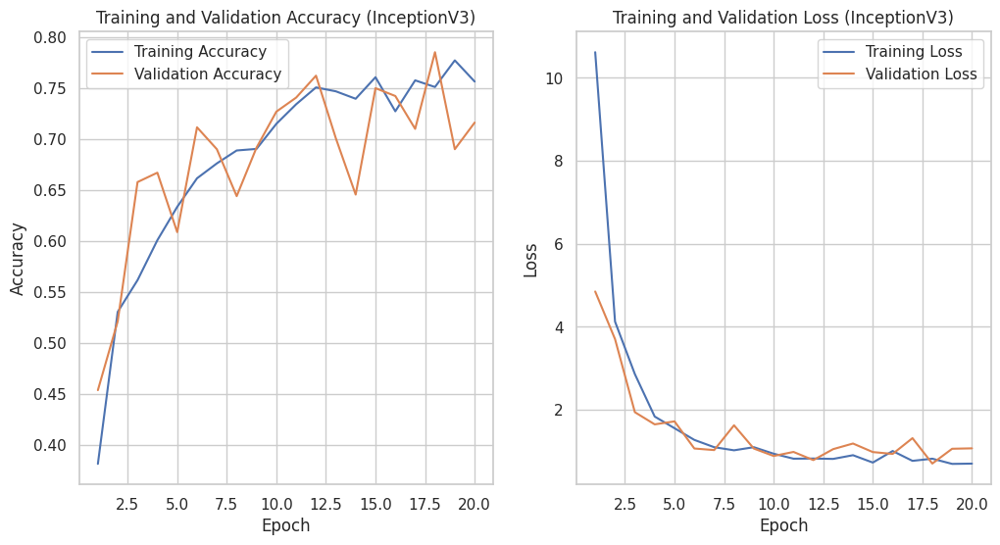

In [ ]:
# Access accuracy, validation accuracy, loss, and validation loss from history
accuracy_inception = history_inception.history['accuracy']
val_accuracy_inception = history_inception.history['val_accuracy']
loss_inception = history_inception.history['loss']
val_loss_inception = history_inception.history['val_loss']

# Plot Training and Validation Accuracy
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(range(1, 21), accuracy_inception, label='Training Accuracy')
plt.plot(range(1, 21), val_accuracy_inception, label='Validation Accuracy')
plt.title('Training and Validation Accuracy (InceptionV3)')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(range(1, 21), loss_inception, label='Training Loss')
plt.plot(range(1, 21), val_loss_inception, label='Validation Loss')
plt.title('Training and Validation Loss (InceptionV3)')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()

##inception v3 after  tuning

In [ ]:
import tensorflow as tf


inception_model = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))


for layer in inception_model.layers:
    layer.trainable = False


model_inception = tf.keras.models.Sequential()
model_inception.add(inception_model)


model_inception.add(tf.keras.layers.GlobalAveragePooling2D())


model_inception.add(tf.keras.layers.Dense(128, activation='relu'))
model_inception.add(tf.keras.layers.Dense(64, activation='relu'))
model_inception.add(tf.keras.layers.Dense(32, activation='relu'))

model_inception.add(tf.keras.layers.Dense(4, activation='softmax'))


model_inception.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


In [ ]:
import matplotlib.pyplot as plt


history_inception = model_inception.fit(xtrain, ytrain, batch_size=128, verbose=1, validation_data=(xtest, ytest), epochs=20)


Epoch 1/20
21/21 [==============================] - 13s 369ms/step - loss: 6.8400 - accuracy: 0.4451 - val_loss: 1.2760 - val_accuracy: 0.5798
Epoch 2/20
21/21 [==============================] - 5s 263ms/step - loss: 1.2318 - accuracy: 0.5803 - val_loss: 0.8912 - val_accuracy: 0.7086
Epoch 3/20
21/21 [==============================] - 6s 266ms/step - loss: 0.9044 - accuracy: 0.6598 - val_loss: 0.8378 - val_accuracy: 0.6488
Epoch 4/20
21/21 [==============================] - 6s 273ms/step - loss: 0.9374 - accuracy: 0.6536 - val_loss: 1.0272 - val_accuracy: 0.6028
Epoch 5/20
21/21 [==============================] - 6s 273ms/step - loss: 0.7319 - accuracy: 0.7055 - val_loss: 0.6632 - val_accuracy: 0.7485
Epoch 6/20
21/21 [==============================] - 6s 276ms/step - loss: 0.7321 - accuracy: 0.7116 - val_loss: 0.6347 - val_accuracy: 0.7239
Epoch 7/20
21/21 [==============================] - 6s 268ms/step - loss: 0.6345 - accuracy: 0.7435 - val_loss: 1.1244 - val_accuracy: 0.5905
Epoch

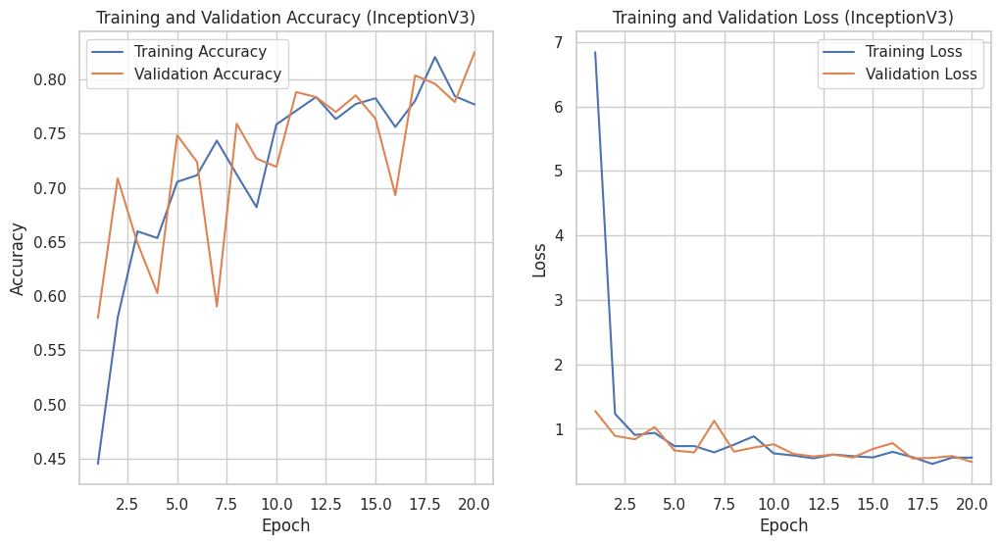

In [ ]:
# Access accuracy, validation accuracy, loss, and validation loss from history
accuracy_inception = history_inception.history['accuracy']
val_accuracy_inception = history_inception.history['val_accuracy']
loss_inception = history_inception.history['loss']
val_loss_inception = history_inception.history['val_loss']

# Plot Training and Validation Accuracy
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(range(1, 21), accuracy_inception, label='Training Accuracy')
plt.plot(range(1, 21), val_accuracy_inception, label='Validation Accuracy')
plt.title('Training and Validation Accuracy (InceptionV3)')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(range(1, 21), loss_inception, label='Training Loss')
plt.plot(range(1, 21), val_loss_inception, label='Validation Loss')
plt.title('Training and Validation Loss (InceptionV3)')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()

##Nasnet

In [ ]:
import tensorflow as tf


nasnet_model = tf.keras.applications.NASNetLarge(weights='imagenet', include_top=False, input_shape=(224, 224, 3))


for layer in nasnet_model.layers:
    layer.trainable = False


model_nasnet = tf.keras.models.Sequential()
model_nasnet.add(nasnet_model)


model_nasnet.add(tf.keras.layers.GlobalAveragePooling2D())


model_nasnet.add(tf.keras.layers.Dense(128, activation='relu'))
model_nasnet.add(tf.keras.layers.Dense(64, activation='relu'))
model_nasnet.add(tf.keras.layers.Dense(32, activation='relu'))


model_nasnet.add(tf.keras.layers.Dense(4, activation='softmax'))


model_nasnet.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])


343610240/343610240 [==============================] - 7s 0us/step


In [ ]:
import matplotlib.pyplot as plt

# Train the model and store the history
model_nasnet = model_nasnet.fit(xtrain, ytrain, batch_size=128, verbose=1, validation_data=(xtest, ytest), epochs=20)


Epoch 1/20
21/21 [==============================] - 74s 2s/step - loss: 1.4324 - accuracy: 0.3913 - val_loss: 1.1393 - val_accuracy: 0.6764
Epoch 2/20
21/21 [==============================] - 38s 2s/step - loss: 1.0812 - accuracy: 0.6375 - val_loss: 0.9497 - val_accuracy: 0.6840
Epoch 3/20
21/21 [==============================] - 35s 2s/step - loss: 0.8518 - accuracy: 0.7354 - val_loss: 0.7431 - val_accuracy: 0.7653
Epoch 4/20
21/21 [==============================] - 39s 2s/step - loss: 0.7214 - accuracy: 0.7469 - val_loss: 0.6456 - val_accuracy: 0.7914
Epoch 5/20
21/21 [==============================] - 39s 2s/step - loss: 0.6346 - accuracy: 0.7707 - val_loss: 0.6452 - val_accuracy: 0.7715
Epoch 6/20
21/21 [==============================] - 36s 2s/step - loss: 0.5927 - accuracy: 0.7723 - val_loss: 0.5492 - val_accuracy: 0.8006
Epoch 7/20
21/21 [==============================] - 39s 2s/step - loss: 0.5557 - accuracy: 0.7861 - val_loss: 0.6289 - val_accuracy: 0.7638
Epoch 8/20
21/21 [==

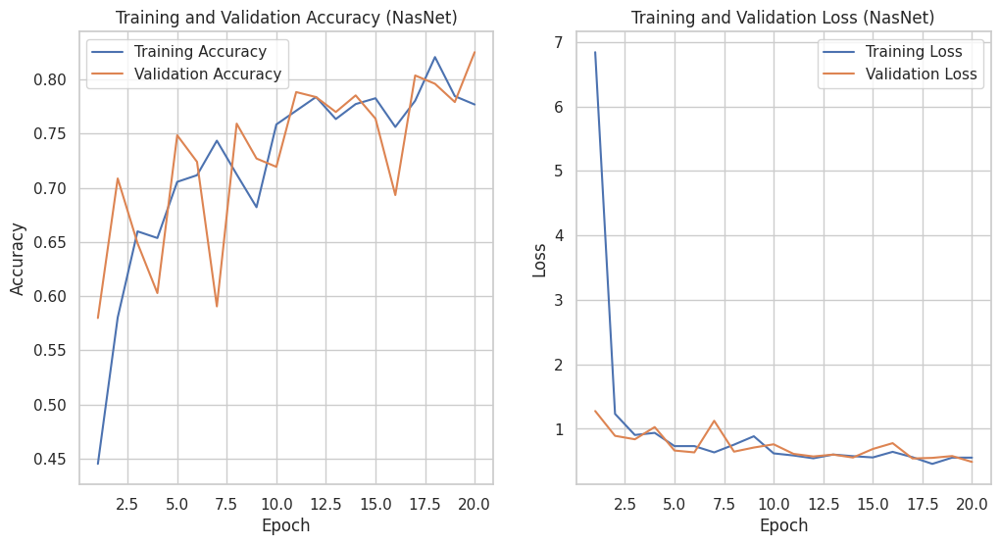

In [ ]:
# Access accuracy, validation accuracy, loss, and validation loss from history
accuracy_inception = history_inception.history['accuracy']
val_accuracy_inception = history_inception.history['val_accuracy']
loss_inception = history_inception.history['loss']
val_loss_inception = history_inception.history['val_loss']

# Plot Training and Validation Accuracy
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(range(1, 21), accuracy_inception, label='Training Accuracy')
plt.plot(range(1, 21), val_accuracy_inception, label='Validation Accuracy')
plt.title('Training and Validation Accuracy (NasNet)')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(range(1, 21), loss_inception, label='Training Loss')
plt.plot(range(1, 21), val_loss_inception, label='Validation Loss')
plt.title('Training and Validation Loss (NasNet)')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()

#Vgg16

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Assuming you have input images of size 224x224 and 3 channels (RGB)
input_shape = (224, 224, 3)
num_classes = 4  # Adjust based on your task

# Load Vision Transformer (ViT) model from TensorFlow Applications
base_model = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=input_shape)

# Freeze the layers of the pre-trained VGG16 model
for layer in base_model.layers:
    layer.trainable = False

# Create a new sequential model and add the VGG16 layers
model_vit = tf.keras.models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(128, activation='relu'),
    layers.Dense(64, activation='relu'),
    layers.Dense(32, activation='relu'),
    layers.Dense(num_classes, activation='softmax')
])

# Compile the model
model_vit.compile(
    optimizer=Adam(),
    loss=SparseCategoricalCrossentropy(),
    metrics=['accuracy']
)


Epoch 1/20
82/82 [==============================] - 12s 149ms/step - loss: 2.9831e-04 - accuracy: 1.0000 - val_loss: 0.0666 - val_accuracy: 0.9877
Epoch 2/20
82/82 [==============================] - 12s 145ms/step - loss: 2.6952e-04 - accuracy: 1.0000 - val_loss: 0.0753 - val_accuracy: 0.9816
Epoch 3/20
82/82 [==============================] - 12s 150ms/step - loss: 2.2743e-04 - accuracy: 1.0000 - val_loss: 0.0786 - val_accuracy: 0.9801
Epoch 4/20
82/82 [==============================] - 12s 152ms/step - loss: 2.1025e-04 - accuracy: 1.0000 - val_loss: 0.0710 - val_accuracy: 0.9847
Epoch 5/20
82/82 [==============================] - 12s 151ms/step - loss: 2.0128e-04 - accuracy: 1.0000 - val_loss: 0.0727 - val_accuracy: 0.9847
Epoch 6/20
82/82 [==============================] - 12s 153ms/step - loss: 1.7524e-04 - accuracy: 1.0000 - val_loss: 0.0736 - val_accuracy: 0.9831
Epoch 7/20
82/82 [==============================] - 12s 153ms/step - loss: 1.6585e-04 - accuracy: 1.0000 - val_loss: 0

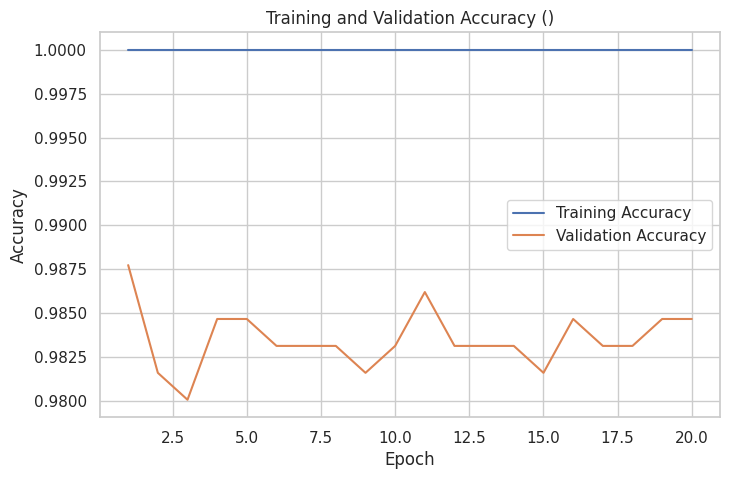

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have xtrain, ytrain, xtest, ytest as your training and testing data

# Train the model and store the history
history_vit = model_vit.fit(xtrain, ytrain, batch_size=32, verbose=1, validation_data=(xtest, ytest), epochs=20)

# Access accuracy and validation accuracy from history
accuracy_vit = history_vit.history['accuracy']
val_accuracy_vit = history_vit.history['val_accuracy']

# Plot Training and Validation Accuracy
plt.figure(figsize=(8, 5))
plt.plot(range(1, 21), accuracy_vit, label='Training Accuracy')
plt.plot(range(1, 21), val_accuracy_vit, label='Validation Accuracy')
plt.title('Training and Validation Accuracy ()')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()
